# Машинное обучение, ВМК МГУ

# Практическое задание 3. Обучение без учителя.

## Общая информация
Дата выдачи: 15.04.2021 23:59MSK

Мягкий дедлайн: 29.04.2021 23:59 MSK

Жёсткий дедлайн: 06.05.2021 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу (без учета бонусов) — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-03-Username.ipynb

Username — ваша фамилия на латинице

<p style="color:#de3815;font-size:25px;">
Напоминание об оформлении и выполнении ноутбука
</p>

* Все строчки должны быть выполнены. Нужно, чтобы output команды можно было увидеть, не запуская ячейки (кроме редких случаев, когда необходимо намеренно скрыть ненужный output, про такие случаи желательно писать пояснения в тексте). **В противном случае -1 балл**
* При оформлении ДЗ нужно пользоваться данным файлом в качестве шаблона. Не нужно удалять и видоизменять написанный код и текст, если явно не указана такая возможность. **В противном случае -1 балл**
* В anytask обязательно нужно прикреплять отдельно файл с расширением ipynb (не в архиве, а именно отдельно). Если необходимо отправить еще какие-то файлы, то вынесите их в отдельный архив (если файлов много) и пришлите. **В противном случае -0.5 балла**
---
* Пишите, пожалуйста, выводы и ответы на вопросы в текстовых ячейках/при помощи print в коде. При их отсутствии мы не можем понять, сделали ли вы задание и понимаете, что происходит, и **поэтому будем снижать баллы**
* Если алгоритм не сказано реализовывать явно, его всегда можно импортировать из библиотеки.
---
* Про графики. _Штрафы будут применяться к каждому результату команды отображения графика (plt.show() и др. аналогичные). Исключением являются графики, генерируемые функциями каких-либо сторонних библиотек, если их нельзя кастомизировать_

    * должно быть название (plt.title) графика; **В противном случае &ndash; -0.05 балла**
    * на графиках должны быть подписаны оси (plt.xlabel, plt.ylabel); **В противном случае &ndash; -0.025 балла за каждую ось**
    * должны быть подписаны единицы измерения (если это возможно); **В противном случае &ndash; -0.025 балла за каждую ось**
    * все названия должны быть понятны любому человеку, знакомому с терминологией, без заглядывания в код; **В противном случае &ndash; -0.05 балла**
    * подписи тиков на осях не должны сливаться как на одной оси, так и между ними; **В противном случае &ndash; -0.025 балла за каждую ось**
    * если изображено несколько сущностей на одном холсте (например несколько функций), то необходима поясняющая легенда (plt.legend); **В противном случае &ndash; -0.05 балла**
    * все линии на графиках должны быть чётко видны (нет похожих цветов или цветов, сливающихся с фоном); **В противном случае &ndash; -0.05 балла**
    * если отображена величина, имеющая очевидный диапазон значений (например, проценты могут быть от 0 до 100), то желательно масштабировать ось на весь диапазон значений (исключением является случай, когда вам необходимо показать малое отличие, которое незаметно в таких масштабах);
    * графики должны быть не супер-микро и не супер-макро по размерам, так, чтобы можно было увидеть все, что нужно.
    * при необходимости улучшения наглядности графиков, можно пользоваться логарифмической шкалой по осям x/y.
    

### Нововведение!

* Для удобства поиска вопросов, на которые от вас просят ответа, мы пометили их знаком (?)
* Даем до +0.3 баллов за выдающиеся успехи по субъективному мнению проверяющих. Этот бонус не апеллируется

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



**Замечание:**
* seed менять нежелательно

In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

**Задание 0 (0.05 балла)**. Опишите свои ощущения от домашки по ЕМ-алгоритму👺 (можно картинкой или мемом).

![alt text](em-alg-mem.jpg "Title")

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции/семинаре. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [542]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''
        
        # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
        # L = D - X
        diag = np.sum(X, axis = 0)
        diag = np.diag(diag)
        L = diag - X
        
        wb, vb = np.linalg.eigh(L)
        
        return vb[:, :self.n_components]

In [151]:
A = np.array([[1, 2],[3, 4]])
A.shape[1]

2

In [152]:
A = np.array([[1, 4, 7],[4, 2, 8], [7, 8, 10]])
rr, r = np.linalg.eigh(A)
rr

array([-3.09830539, -2.52966542, 18.62797081])

In [154]:
r

array([[ 0.47429168, -0.77599902, -0.4157799 ],
       [ 0.61553292,  0.62995636, -0.47357598],
       [-0.62941769,  0.03131306, -0.776436  ]])

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [543]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

**Замечание**
* Для возможности получения **полного балла** assert должны проходить

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

**Замечание**
* (?) Напишите, пожалуйста, откуда в итоге скачивали данные. 

**Взял по первой ссылке**

In [539]:
data = pd.read_excel('City surface public transport stops.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [172]:
data['Longitude_WGS84_en'][20]

37.57511066

In [48]:
data['RouteNumbers_en'][:20]

0                          АТ18; А12; АТ56; АТ78
1                    АТ47; АМ10; АТ3; АТ56; АТ78
2         А64; А216; А809; АС12; А255; АБК; АТ79
3         А64; А216; А809; АС12; А255; АБК; АТ79
4         А64; А216; А809; АС12; А255; АБК; АТ79
5                     А64; А216; АС12; А255; АМ3
6                      А64; А15; АС12; А255; АМ3
7                                      А64; АС12
8                          А64; А216; А809; А255
9                          А64; А216; А809; А255
10              А64; АБК; АС12; АТ10; АТ39; АТ79
11              А64; АБК; А869; АТ10; АТ39; АТ79
12              А850; А64; АС43; А869; АМ6; АТ79
13         А64; А39; АС43; А869; АМ6; АТ35; АТ79
14         А64; А39; АС43; А869; АМ6; АТ35; АТ79
15         А64; А39; АС43; А869; АМ6; АТ35; АТ79
16    А850; А64; А39; АС43; А69; А869; АМ6; АТ79
17               А64; А869; АТ10; АБ; АТ39; АТ79
18               А64; А869; АТ10; АБ; АТ39; АТ79
19                                     А64; АС12
Name: RouteNumbers_e

In [40]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


Воспользуемся библиотекой `folium` для визуализации данных.

In [46]:
import folium

map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map_)
map_

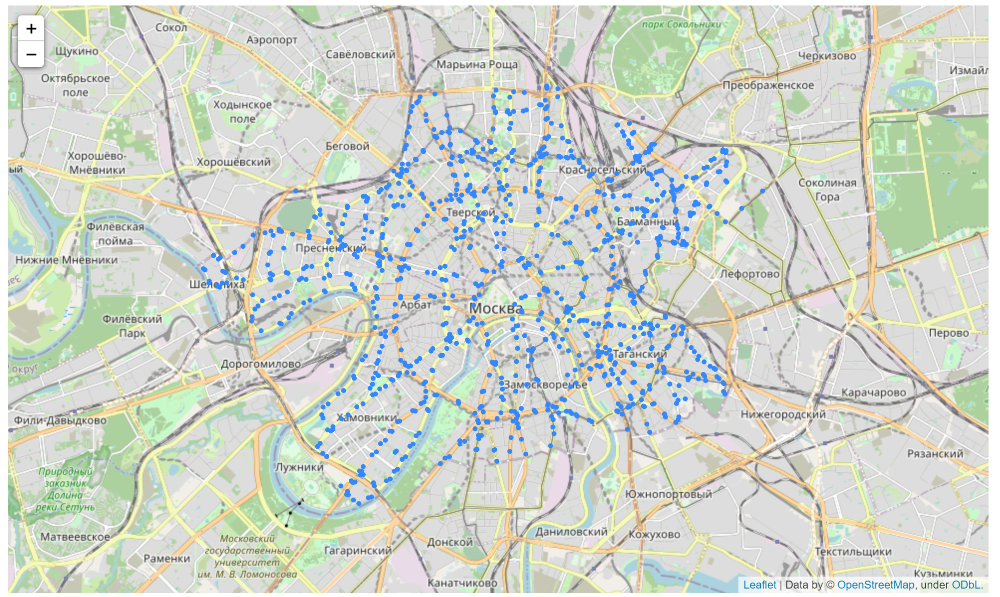

In [6]:
Image(r"C:\Users\User\Jupiter_notebook\map_1.png")

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [132]:
data['RouteNumbers_en']

0                        АТ18; А12; АТ56; АТ78
1                  АТ47; АМ10; АТ3; АТ56; АТ78
2       А64; А216; А809; АС12; А255; АБК; АТ79
3       А64; А216; А809; АС12; А255; АБК; АТ79
4       А64; А216; А809; АС12; А255; АБК; АТ79
                         ...                  
1032                                        АК
1033                                      А869
1034                                      АМ71
1035                                      АО47
1036                                      А869
Name: RouteNumbers_en, Length: 1037, dtype: object

In [159]:
n = d.get(s[0])
n.append(5)
d['АТ18'] = n
d

{'АТ18': [11, 5], '2': [22], '3': [33]}

In [237]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    d = {}
    for i in range(len(data['RouteNumbers_en'])):
        splt = data['RouteNumbers_en'][i].split('; ')
        for j in splt:
            if j in d:
                d[j] += [i]
            else:
                d[j] = [i]
                
    return d

def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    for key in routes:
        unsort = routes[key]
        coords = []
        sort = []
        for i in unsort:
            coords += [(data['Longitude_WGS84_en'][i], data['Latitude_WGS84_en'][i])]
        dist_matrix = distance.cdist(coords, coords, 'euclidean')
        dist_matrix += np.diag([1e5]*len(unsort))
        INF = 1e5
        dist_sum = np.sum(dist_matrix, axis = 1)
        first_index = np.argmax(dist_sum)
        sort += [unsort[first_index]]
        check = first_index
        for j in range(len(unsort) - 1):
            next_index = np.argmin(dist_matrix[check])
            dist_matrix[check, :] = INF
            dist_matrix[:, check] = INF
            sort += [unsort[next_index]]
            check = next_index
        routes[key] = sort
    return routes

def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    adjacency_matrix = np.zeros((len(data), len(data)))
    for key in sorted_routes:
        mass = sorted_routes[key]
        for i in range(len(mass) - 1):
            adjacency_matrix[mass[i], mass[i+1]] += 1
            adjacency_matrix[mass[i+1], mass[i]] += 1
    return adjacency_matrix

In [198]:
np.diag(np.array([100]*2))

array([[100,   0],
       [  0, 100]])

In [238]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

In [239]:
np.sum(adjacency_matrix)

6074.0

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [217]:
map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map_)

map_

In [17]:
#Image(r"C:\Users\User\Jupiter_notebook\map_2.png")

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [548]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵
    
    #print(unique)
    colors = ['red', "green", 'blue', 'coral', 'gold', 'lime', 'maroon', 'darkblue', 'orchid', 'purple', 'black','yellowgreen',
              'yellow','turquoise', 'white' ] * 5
    
    map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
    for id, row in data.iterrows():
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10, color = colors[labels[id]]).add_to(map_)
    return map_

**Задание 1.4 (1.5 балла)**. 

* **(0.25 балла)** Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. В этом пункте используйте дефолтные параметры.
* **(0.25 балла)** Визуализируйте результат кластеризации из предыдущего пункта с помощью функции `draw_clustered_map`.
* **(0.75 балла)** А теперь подберите параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации. Визуализируйте полученные результаты для всех трех алгоритмов на *оптимальных параметрах*
* (?) Проинтерпретируйте полученные результаты.
 * **(0.1 балла)** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами?
 * **(0.1 балла)** Какие плюсы и минусы есть у каждого алгоритма?
 * **(0.05 балла)** Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).
* Обращайте внимание на баланс объектов в кластерах.

In [261]:
#data[['Latitude_WGS84_en', 'Longitude_WGS84_en']]

In [330]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
from sklearn.cluster import KMeans
kmeans = KMeans().fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
kmeans_labels = kmeans.labels_

In [286]:
draw_clustered_map(data, kmeans_labels)

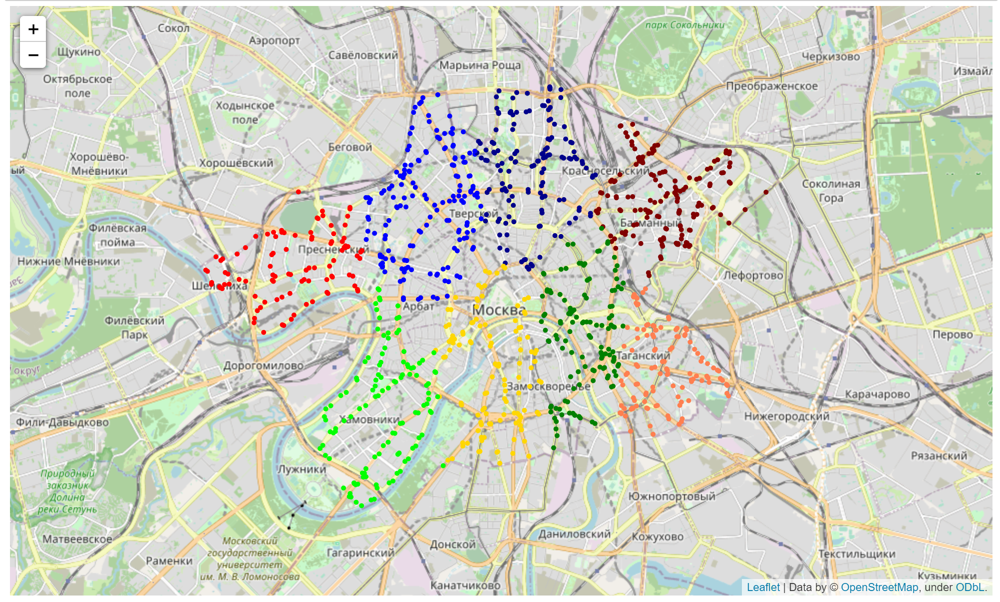

In [8]:
from IPython.display import Image
Image(r"C:\Users\User\Jupiter_notebook\map_3.png")

In [306]:
from sklearn.cluster import DBSCAN
clustering = DBSCAN().fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
DBSCANS_labels = clustering.labels_

In [308]:
np.unique(DBSCANS_labels)

array([0], dtype=int64)

In [288]:
draw_clustered_map(data, DBSCANS_labels)

In [19]:
#Image(r"C:\Users\User\Jupiter_notebook\map_4.png")

теперь наш

In [291]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

In [304]:
graph_clustering = GraphClustering()
our_spectral_clustering= graph_clustering.fit_predict(adjacency_matrix)

In [309]:
np.unique(our_spectral_clustering)

array([0, 1, 2, 3, 4, 5, 6, 7])

In [313]:
draw_clustered_map(data, our_spectral_clustering)

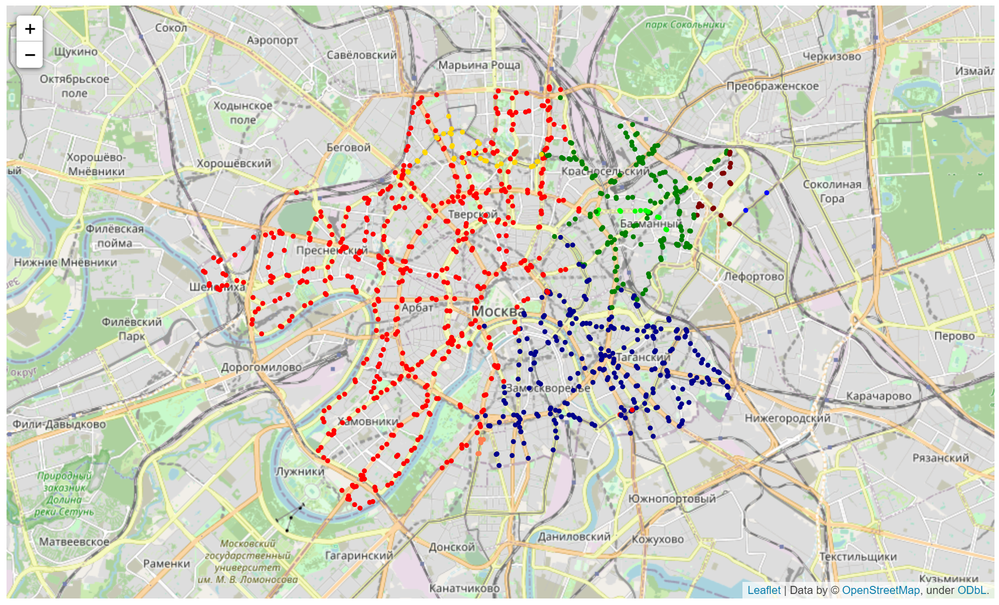

In [22]:
Image(r"C:\Users\User\Jupiter_notebook\map_5.png")

теперь попробуем подобрать правильные параметры для трех моделей

In [355]:
kmeans_new = KMeans(n_clusters=10).fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
kmeans_labels_new = kmeans_new.labels_
draw_clustered_map(data, kmeans_labels_new)

In [20]:
#Image(r"C:\Users\User\Jupiter_notebook\map_6.png")

остановки кластеризовались примерно по районам

In [ ]:
#00157

In [489]:
clustering_new = DBSCAN(eps=0.00389).fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
DBSCANS_labels_new = clustering_new.labels_
draw_clustered_map(data, DBSCANS_labels_new)

In [18]:
#Image(r"C:\Users\User\Jupiter_notebook\map_7.png")

In [490]:
np.unique(DBSCANS_labels_new)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15,
       16, 17, 18, 19, 20, 21, 22], dtype=int64)

здесь было неплохо

In [491]:
clustering_new = DBSCAN(eps=0.00157).fit(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
DBSCANS_labels_new = clustering_new.labels_
draw_clustered_map(data, DBSCANS_labels_new)

In [16]:
#Image(r"C:\Users\User\Jupiter_notebook\map_8.png")

In [503]:
# 15 10

In [530]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)
graph_clustering_new = GraphClustering(n_clusters=15, n_components=11)
our_spectral_clustering_new = graph_clustering_new.fit_predict(adjacency_matrix)
draw_clustered_map(data, our_spectral_clustering_new)

In [15]:
#Image(r"C:\Users\User\Jupiter_notebook\map_9.png")

алгоритм kmeans может относить к одному кластеру на границах точки с разных маршрутов, хотя иногда они могут быть рядом, но на параллельных дорогах. Это минус,которого нет у спектральной кластеризации, матрицу смежности мы строили исходя из соседних остановок по маршруту. Из всех трех лучше всего показали себя kmeans и спектральная кластеризация. Самый применимый именно последний алгоритм к кластеризации остановок, потому что он учитывает соединения марштутов, однако k-means можно применять, потому с ним легче всего работать и не нужно подбирать параметры. DBSCAN показался самым сложным в применении.

-----

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [893]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1839,tech,016.txt,Global blogger action day called,The global web blog community is being called...
1486,sport,174.txt,Cudicini misses Carling Cup final,Chelsea goalkeeper Carlo Cudicini will miss S...
936,politics,041.txt,Profile: David Blunkett,Before he resigned the position of home secre...
188,business,189.txt,Fiat chief takes steering wheel,The chief executive of the Fiat conglomerate ...
1325,sport,013.txt,Kenya lift Chepkemei's suspension,Kenya's athletics body has reversed a ban on ...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть🙈, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [558]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [559]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [560]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [561]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [562]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [563]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

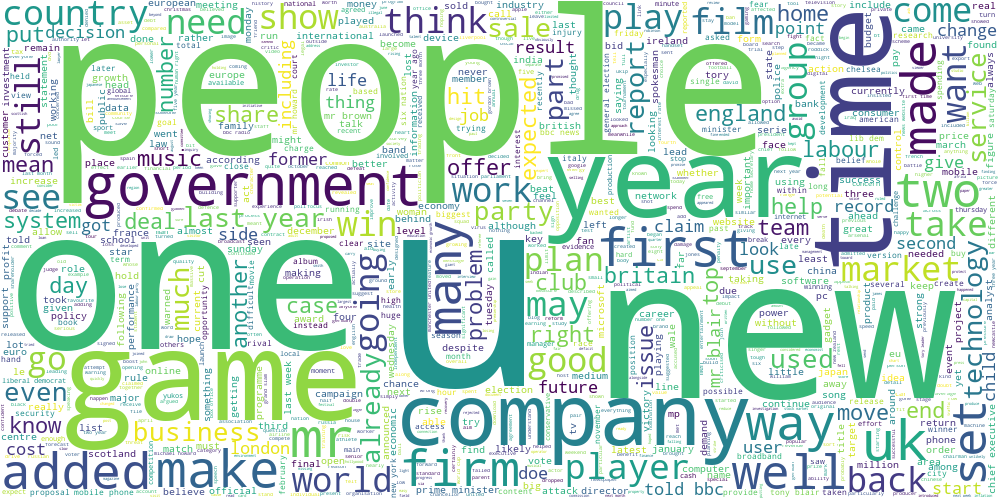

In [564]:
draw_wordcloud(data.text)

-----

**Задание 2.1 (1 балл).** 

* **(0.5 балла)** Обучите алгоритм K-Means на tf-idf представлениях текстов. 
* **(0.25 балла)** Постройте облака тегов для текстов из разных кластеров.
* **(0.25 балла)** (?) Получились ли темы интерпретируемыми? (?) Попробуйте озаглавить каждую тему.

**Подсказки:**
* Можно использовать готовую реализацию tf-idf векторайзера из sklearn
* При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова.
* Воздержитесь от использования N-грамм при обучении tf-idf.
* Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8).

**Ключевые слова:**
* *TfidfVectorizer*

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

In [573]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df = 0.005)
Xvec = vectorizer.fit_transform(data.text)

In [574]:
Xvec.shape

(2225, 4263)

In [576]:
n_clusters = 8

In [578]:
kmeans_tf_idf = KMeans(n_clusters=n_clusters).fit(Xvec)
kmeans_labels_tf_idf = kmeans_tf_idf.labels_


In [580]:
np.unique(kmeans_labels_tf_idf)

array([0, 1, 2, 3, 4, 5, 6, 7])

In [581]:
from matplotlib import pyplot as plt

**1. BUISNESS**

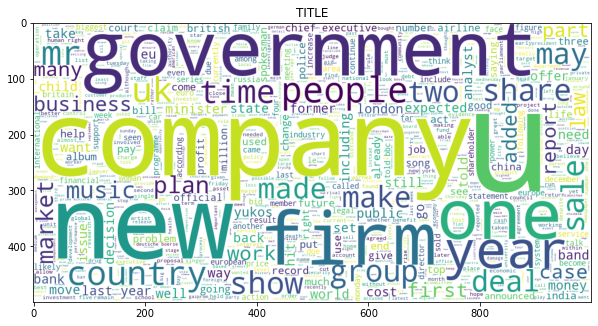

In [593]:
fig, ax = plt.subplots(figsize = (10, 8))
#plt.title('TITLE')

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 0]))

plt.show()

**2. ECONOMY**

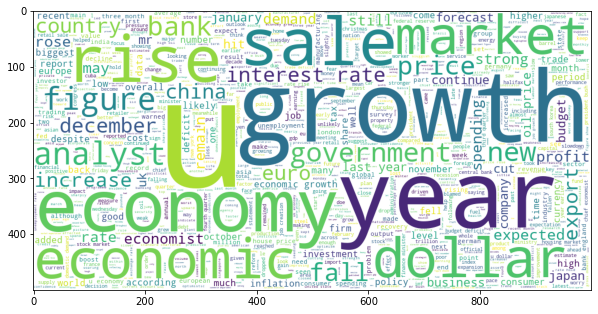

In [584]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 1]))

plt.show()

**3. ENGLISH FOOTBALL LEAGUE**

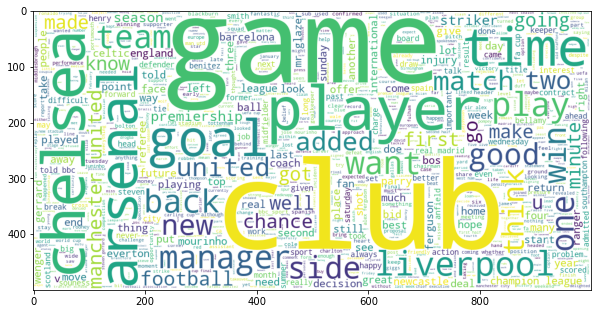

In [585]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 2]))

plt.show()

**4. CREATIONS and FILMS**

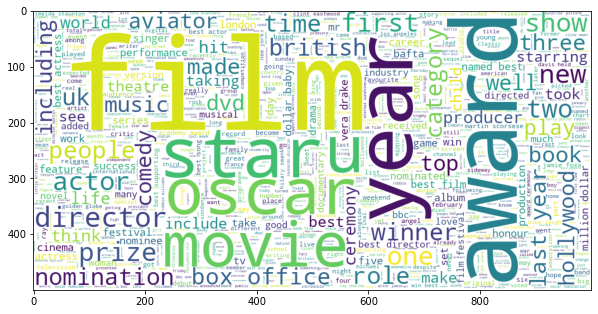

In [586]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 3]))

plt.show()

**5. POLITICS**

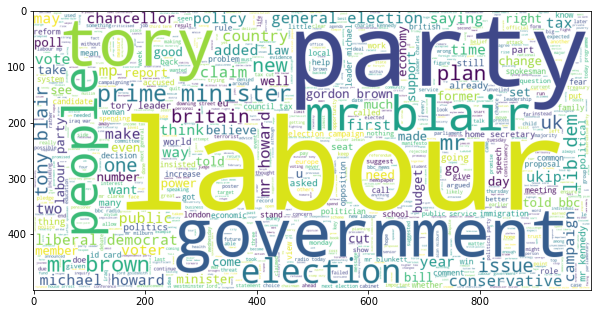

In [587]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 4]))

plt.show()

**6. TECNIQUE**

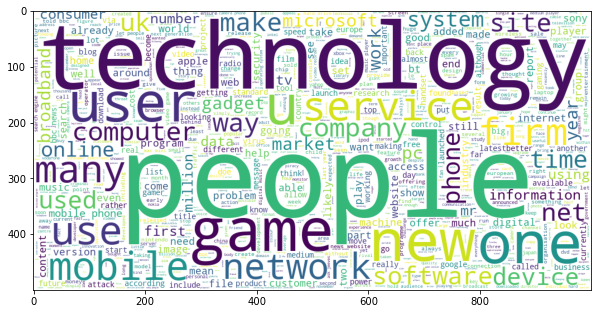

In [588]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 5]))

plt.show()

**7. WORLD LEAGUE**

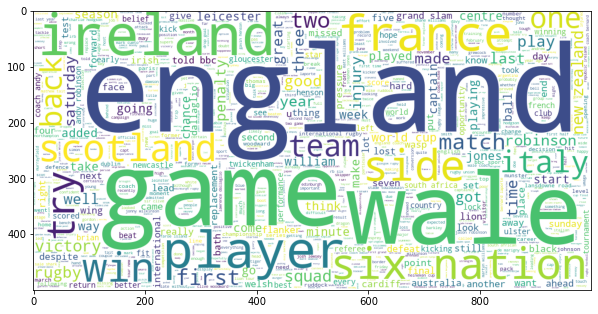

In [589]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 6]))

plt.show()

**8. FINAL POINT OF GAME**

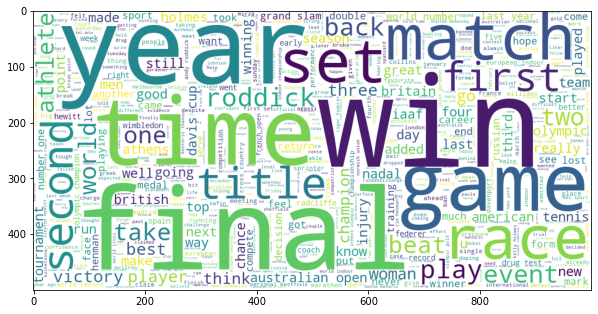

In [590]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels_tf_idf == 7]))

plt.show()

темы получились интерпретируемыми

-----

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. 

* **(0.3 балла)** Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков tf-idf максимальны.
* **(0.2 балла)** (?) Согласуются ли полученные слова с облаками тегов из прошлого задания?

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

In [629]:
num_of_key_words = 6
for i in range(n_clusters):
    mid = kmeans_tf_idf.cluster_centers_[i]
    key_words = mid.argsort()[-num_of_key_words:]
    print("cluster №", i+1, "key words:")
    for i in range(num_of_key_words):
        print(vectorizer.get_feature_names()[key_words[i]], end =" ")
    print("\n")

cluster № 1 key words:
government would firm year mr company 

cluster № 2 key words:
year economic price rate economy growth 

cluster № 3 key words:
league arsenal united game chelsea club 

cluster № 4 key words:
star oscar actor best award film 

cluster № 5 key words:
tory blair party election labour mr 

cluster № 6 key words:
user game technology people phone mobile 

cluster № 7 key words:
france game rugby ireland wale england 

cluster № 8 key words:
win seed olympic world open champion 



**Ваш ответ здесь:**

ключевые слова действительно согласуются с темами

In [630]:
#x = [1, 2, 3, 4, 5, 6, 7, 8]
#x[2:]

-----

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). 

* п.1 Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации. 
 * **(0.3 балла)** При этом для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров;
 * **(0.5 балла)** Подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.
* п.2 **(0.5 балла)** Обучите двухмерные t-SNE ([Почитать можно тут, часть 2](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture11-unsupervised.pdf), а также посмотреть непосредственно в [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)) представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом.
* п.3 **(0.2 балла)** (?) Прокомментируйте получившиеся результаты. (?) Какой баланс кластеров получился у разных методов? (?) Соотносятся ли визуализации для текстов с визуализациями для географических данных?


**Замечания:**
* В этом задании используйте реализации спектральной кластеризации и t-SNE из `sklearn`
* В п.2 Лучше всего расположить визуализации на одном графике на трех разных сабплотах. 

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

In [639]:
n_clusters = 6

In [640]:
kmeans_clustering = KMeans(n_clusters=n_clusters).fit(Xvec)
kmeans_labels= kmeans_clustering.labels_

In [641]:
np.unique(kmeans_labels).shape[0]

6

In [730]:
Xvec.shape

(2225, 4263)

In [866]:
from sklearn.neighbors import NearestNeighbors
def get_matrix(X):
    k = int(X.shape[0] * 0.04)
    print(k)
    neigh = NearestNeighbors(n_neighbors=k)
    neigh.fit(X)
    NearestNeighbors(n_neighbors=k)
    A = neigh.kneighbors_graph(X)
    return A.toarray()
    

In [867]:
adjacency_matrix = get_matrix(Xvec)
adjacency_matrix.shape

89


(2225, 2225)

In [868]:
adjacency_matrix = adjacency_matrix * adjacency_matrix.T

In [870]:
graph_clustering = GraphClustering(n_clusters=6, n_components=6)
our_spectral_clustering = graph_clustering.fit_predict(adjacency_matrix)

In [871]:
np.unique(our_spectral_clustering)

array([0, 1, 2, 3, 4, 5])

подберем параметры для DBscan

In [646]:
DBSCAN_clustering = DBSCAN(eps = 0.81).fit(Xvec)
DBSCANS_labels = DBSCAN_clustering.labels_

In [647]:
np.unique(DBSCANS_labels).shape[0]

6

подобрали eps так, что получилось то же количество кластеров, что и k-means и спектральной кластеризации

**t-SNE**

In [650]:
from sklearn.manifold import TSNE

In [651]:
X_embedded = TSNE(n_components=2).fit_transform(Xvec.toarray())

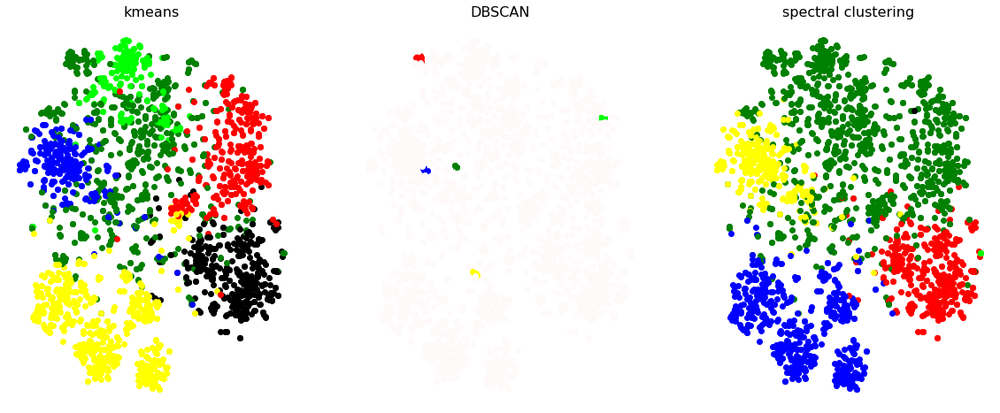

In [873]:
fig, ax = plt.subplots(figsize = (20, 8))
colors = ["red", 'green', 'blue', 'yellow', 'lime', 'black', 'darkblue', 'orchid', 'purple', 'snow'] * 3

plt.axis('off')
ax = fig.add_subplot(131)
plt.title("kmeans", fontsize = 16)
for idx in range(len(kmeans_labels)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[kmeans_labels[idx]])
plt.axis('off')


ax = fig.add_subplot(132)
plt.title("DBSCAN", fontsize = 16)
for idx in range(len(DBSCANS_labels)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[DBSCANS_labels[idx]])
plt.axis('off')

ax = fig.add_subplot(133)
plt.title("spectral clustering", fontsize = 16)
for idx in range(len(DBSCANS_labels)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[our_spectral_clustering[idx]])
plt.axis('off')

plt.show()

Можно сделать вывод, что k_means работает неплохо и его географическое представление соотносится с визуализацией для текстов. spectral clustering дает похожие результаты, но многое завиит от того, как мы будем строить матрицу смежности. А это в свою очередь зависило от того, сколько ближайших соседей мы брали для каждого вектора. 

Нормально настроить dbscan не выходило, чтобы он давал такое же количество классов (6), но результаты были адекватными. Возможно такое eps и существует, но найти его очень сложно. Вообще этот алгоритм оказывается наименее удачным из трех

-----

**Задание 2.4 (1.5 балла).** 

* **(0.5 балла)**  Обучите модель латентного размещения Дирихле (LDA).
* **(0.5 балла)**  Придумайте как превратить распределение тем для текста в номер его кластера. Опишите текстом (?) и приведите код и результаты его работы
* **(0.5 балла)** Возьмите параметр `n_components` у LDA в 2-3 раза больше, чем число кластеров для K-Means, и вновь посмотрите на темы. (?) Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Замечания:**
* Реализацию LDA во всех заданиях используйте из `sklearn` (LatentDirichletAllocation)

**Подсказка:**
* Не забудьте, что LDA работает с мешком слов, а не с tf-idf признаками.

**Ключевые слова:**
* *CountVectorizer,  LatentDirichletAllocation*

In [663]:
from sklearn.decomposition import LatentDirichletAllocation

In [664]:
from sklearn.feature_extraction.text import CountVectorizer

In [665]:
vectorizer = CountVectorizer()
X_cnt_vec = vectorizer.fit_transform(data.text)

In [666]:
lda = LatentDirichletAllocation(n_components=6)
lda.fit(X_cnt_vec)

LatentDirichletAllocation(n_components=6)

In [667]:
problems = lda.transform(X_cnt_vec)
problems.shape

(2225, 6)

чтобы превратить распределение тем для текста в номер его кластера, возьмем argmax по 1 оси. Это и будет его кластером 

In [670]:
LDA_prob = problems.argmax(axis = 1)

In [671]:
LDA_prob.shape

(2225,)

In [669]:
#problems

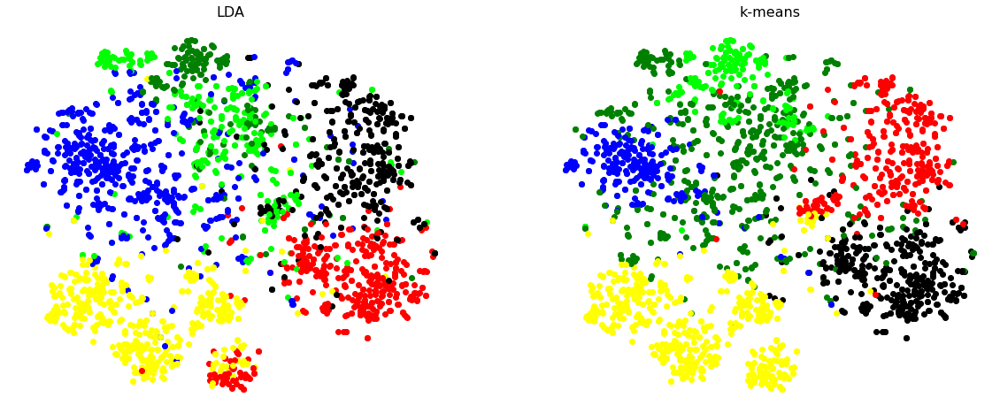

In [728]:
fig, ax = plt.subplots(figsize = (20, 8))
colors = ["red", 'green', 'blue', 'yellow', 'lime', 'black', 'darkblue', 'orchid', 'purple', 'snow'] * 3

plt.axis('off')
ax = fig.add_subplot(121)
plt.title("LDA", fontsize = 16)
for idx in range(len(LDA_prob)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[LDA_prob[idx]])
plt.axis('off')


ax = fig.add_subplot(122)
plt.title("k-means", fontsize = 16)
for idx in range(len(kmeans_labels)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[kmeans_labels[idx]])
plt.axis('off')

plt.show()

In [673]:
lda_mul2 = LatentDirichletAllocation(n_components=18)
lda_mul2.fit(X_cnt_vec)

LatentDirichletAllocation(n_components=18)

In [674]:
problems_mul2 = lda_mul2.transform(X_cnt_vec)

In [675]:
LDA_prob_mul2 = problems_mul2.argmax(axis = 1)

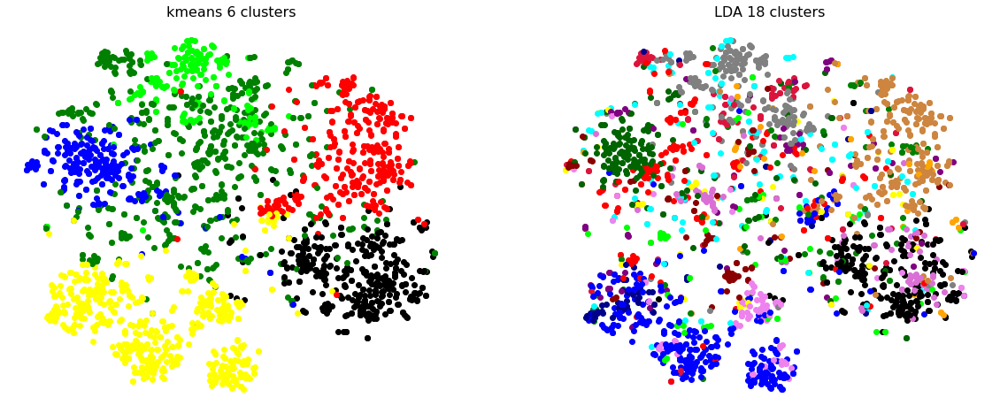

In [727]:
fig, ax = plt.subplots(figsize = (20, 8))
colors = ["red", 'green', 'blue', 'yellow', 'lime', 'black', 'darkblue', 'orchid', 'purple', 'gray', 'orange', 'crimson',
          'cyan', 'darkgreen', 'aqua', 'darkred', 'peru', 'violet', 'snow'] * 3

plt.axis('off')
ax = fig.add_subplot(121)
plt.title("kmeans 6 clusters", fontsize = 16)
for idx in range(len(kmeans_labels)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[kmeans_labels[idx]])
plt.axis('off')


ax = fig.add_subplot(122)
plt.title("LDA 18 clusters", fontsize = 16)
for idx in range(len(LDA_prob_mul2)):
    plt.scatter(X_embedded[idx, 0], X_embedded[idx, 1], color = colors[LDA_prob_mul2[idx]])
plt.axis('off')

plt.show()

попробуем вывести некоторые части

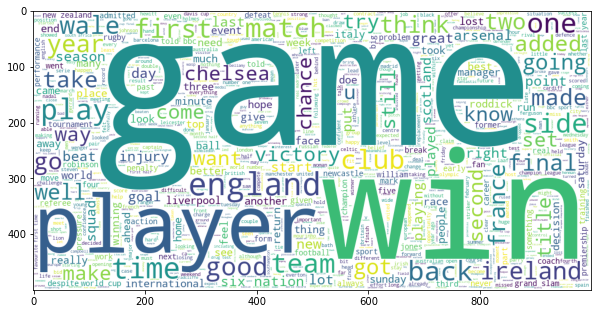

In [701]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels == 3]))

plt.show()

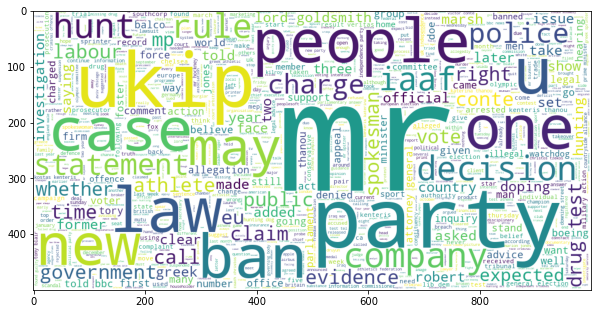

In [702]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[LDA_prob_mul2 == 15]))

plt.show()

**из класса игр смогли выделить класс слов связанных с законов**

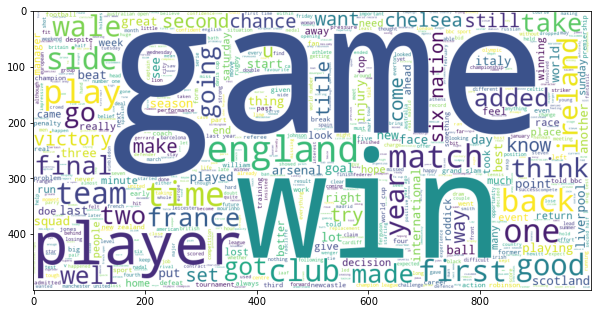

In [695]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[kmeans_labels == 3]))

plt.show()

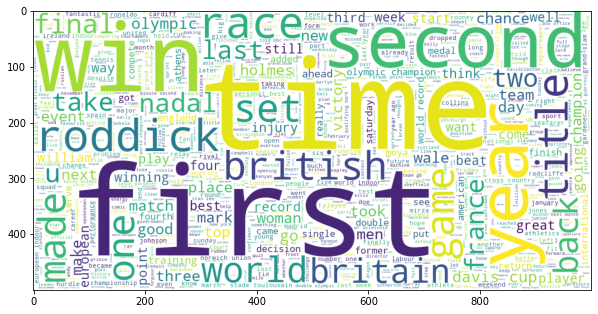

In [693]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[LDA_prob_mul2 == 17]))

plt.show()

**также подвыделился класс связанный именно с положениями в соревнованиях а не просто с играми**

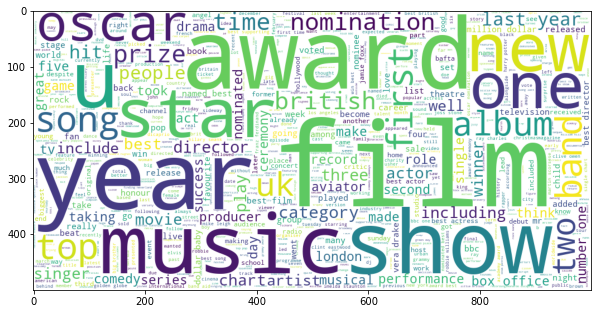

In [709]:
fig, ax = plt.subplots(figsize = (10, 8))

plt.imshow(draw_wordcloud(data.text[LDA_prob_mul2 == 5]))

plt.show()

**также смогли выделить подкатегорию связанную не просто с фильмамми и творчеством, а ближе к музыки**

-----

## Часть 3. Transfer learning для задачи классификации текстов

**Замечание для всей части 3:**
* Для возможности получения **полного балла** accuracy всех алгоритмов на тесте должны быть не ниже 0.75, а также хотя бы один из рассмотренных в этой части алгоритмов должен достигнуть точности не менее 0.95 на тесте.

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей 🌚🌝. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

* **(0.4 балла)** Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.
* **(0.1 балла)** (?) У какой модели получилось лучшее качество? (?) С чем это связано?

**Подсказка:**
* Во второй модели расстояния до центров кластеров можно получиться при помощи метода KMeans.transform

**Ключевые слова:**
* *OrdinalEncoder, TfidfVectorizer, CountVectorizer, train_test_split, KMeans.transform*

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Ваш ответ здесь:**

In [894]:
from sklearn.model_selection import train_test_split

In [895]:
target = data['category']
target

0       business
1       business
2       business
3       business
4       business
          ...   
2220        tech
2221        tech
2222        tech
2223        tech
2224        tech
Name: category, Length: 2225, dtype: object

In [899]:
np.unique(target)

array(['business', 'entertainment', 'politics', 'sport', 'tech'],
      dtype=object)

In [901]:
cnt = 0
for i in np.unique(target):
    target[np.where(target == i)[0]] = cnt
    cnt += 1
target

0       0
1       0
2       0
3       0
4       0
       ..
2220    4
2221    4
2222    4
2223    4
2224    4
Name: category, Length: 2225, dtype: object

In [922]:
X_train_tfidf, X_test_tfidf, y_train_tfidf, y_test_tfidf = train_test_split(Xvec, list(target), test_size=0.30, random_state=42)
X_train_cnt, X_test_cnt, y_train_cnt, y_test_cnt = train_test_split(X_cnt_vec, list(target), test_size=0.30, random_state=42)

In [927]:
X_train_cnt.shape

(1557, 24207)

In [928]:
X_train_tfidf.shape

(1557, 4263)

логистическая регрессия

In [933]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression().fit(X_train_tfidf, y_train_tfidf)
logreg_pr = logreg.predict(X_train_tfidf)
print('logreg train accuracy', (logreg_pr == y_train_tfidf).mean())
logreg_pr = logreg.predict(X_test_tfidf)
print('logreg test accuracy', (logreg_pr == y_test_tfidf).mean())

logreg train accuracy 0.9961464354527938
logreg test accuracy 0.9745508982035929


K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

In [936]:
from scipy.sparse import coo_matrix, vstack

In [938]:
import warnings
warnings.simplefilter("ignore")

In [940]:
n_clusters = 30
kmeans = KMeans(n_clusters = n_clusters)
X_train_cc = kmeans.fit_transform(X_train_tfidf)
X_test_cc = kmeans.transform(X_test_tfidf)
logreg_cc = LogisticRegression().fit(X_train_cc, y_train_tfidf)

logreg_pr_cc = logreg_cc.predict(X_train_cc)
print('logreg in distance to centers train accuracy', (logreg_pr_cc == y_train_tfidf).mean())
logreg_pr_cc = logreg_cc.predict(X_test_cc)
print('logreg in distance to centers test accuracy', (logreg_pr_cc == y_test_tfidf).mean())


logreg in distance to centers train accuracy 0.9428387925497752
logreg in distance to centers test accuracy 0.9416167664670658


Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

In [946]:
lda = LatentDirichletAllocation().fit(X_train_cnt)
X_train_lda = lda.transform(X_train_cnt)
X_test_lda = lda.transform(X_test_cnt)
logreg_lda = LogisticRegression().fit(X_train_lda, y_train_cnt)

logreg_pred_lda = logreg_lda.predict(X_train_lda)
print('logreg in probs topic train accuracy', (logreg_pred_lda == y_train_cnt).mean())
logreg_pred_lda = logreg_lda.predict(X_test_lda)
print('logreg in probs topic test accuracy', (logreg_pred_lda == y_test_cnt).mean())

logreg in probs topic train accuracy 0.844572896596018
logreg in probs topic test accuracy 0.9101796407185628


качество на всех моделях выше 0.75 и существует а также хотя бы один из рассмотренных в этой части алгоритмов достигет точности не менее 0.95 на тесте.

**Лучше всего себя проявила логичтическая регрессия.**

Вероятно это связано с тем, что логичтической регрессии удобно работатть с такого вида данными. Темы хорошо интерпретируются и отделяются друг от друга. Признаков достоточно много - 1500+ (большая размерность)

-----

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры (tf-idf, bag_of_words) и алгоритмы кластеризации (KMeans)) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%).

* **(1.2 балла)** Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 
* **(0.3 балла)** (?) Как изменились результаты по сравнению с обучением на полной разметке? (?) Сделайте выводы.

**Пояснение:**
* Тестовую выборку возьмите из задания 3.1. А разделять надо тренировочную из 3.1
* Обучаете векторайзер на 70%, применяете векторайзер к 5%, и на этих 5% уже обучаете классификатор.
* Итак, берем 3 варианта обучения из задания 3.1. Вы должны:
 * 1-я модель. Подобрать оптимальный гиперпараметр С у LogisticRegression на tf-idf признаках. Выбираем оптимальный параметр по валидационной выборке. Далее оцениваем обученную модель с оптимальном параметром на тесте.
 * 2-я модель. Шаг 1. Подобрать оптимальный гиперпараметр n_clusters у KMeans на tf-idf признаках: перебираем значения n_clusters и при каждом значении обучаем LogisticRegression на дефолтных параметрах (быть может с ограничением max_iter, об этом ниже). То есть классификатор в данном случае будет на одинаковых параметрах для всех представителей семейства алгоритмов KMeans. Далее выбираете оптимальный n_clusters по качеству классификатора на валидационной выборке. Шаг 2. Обучаете KMeans с оптимальным n_clusters и перебираете значение C у LogisticRegression. Также выбираете оптмальное по валидации. И только после двух подобранных оптимальных параметров выводите качество на тесте.
 * 3-я модель. Аналогично второй, только вместо KMeans --- LatentDirichletAllocation, а вместо tf-idf -- bag of words.

**Замечания:**
* Параметр $С$ у LogisticRegression перебирайте *по логарифмической сетке.* Обратите внимание, что $С$ НЕ перед регуляризатором, поэтому, скорее всего, наиболее оптимальными будут большие значения $C$. **Для возможности получения полного балла** переберите хотя бы 20 параметров, и затроньте значения в 1e-2 и 1e6 (по большей части значения должны лежать в этом отрезке)
* **Для возможности получения полного балла** параметр n_clusters у KMeans при переборе должен затрагивать значения в 10 и 1000 кластеров (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не менее 20 значений кластеров *(по линейной сетке)*
* **Для возможности получения полного балла** параметр n_components у LDA при переборе должен затрагивать значения в 5 и 14 (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не меньше 10 различных значений *(по линейной сетке)*

**Подсказка:**
* Может быть для ограничения времени обучения лучше будет ограничить параметр max_iter в LogisticRegression, равным, например, 1000

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

In [978]:
# +-5%                   +-65%
x_train_tagg_tfidf, x_train_notagg_tfidf, y_train_tagg_tfidf, y_train_notagg_tfidf = train_test_split(X_train_tfidf, y_train_tfidf, test_size=65/70, random_state=42)
x_train_tagg_cnt,   x_train_notagg_cnt,   y_train_tagg_cnt,   y_train_notagg_cnt   = train_test_split(X_train_cnt,   y_train_cnt,   test_size=65/70, random_state=42)


In [980]:
x_train_tagg_tfidf.shape, x_train_notagg_tfidf.shape

((111, 4263), (1446, 4263))

In [981]:
X_train_tfidf.shape, X_test_tfidf.shape

((1557, 4263), (668, 4263))

In [1001]:
x_train_tagg_cnt.shape, x_train_notagg_cnt.shape

((111, 24207), (1446, 24207))

In [968]:
def get_C_log (a, b, num):
    res = [a]
    step = (a / b)**(1 / (num - 1))
    for i in range(1, num-1):
        next_el = res[-1] * step
        res += [next_el]
    res += [b]
    return res

In [983]:
number = 20
C = np.array(get_C_log(1e-2, 1e+6, number))
check = np.zeros(number)

for i in range(number):
    logreg = LogisticRegression(C=C[i], max_iter=1000).fit(x_train_tagg_tfidf, y_train_tagg_tfidf)
    check[i] = (logreg.predict(x_train_notagg_tfidf) == y_train_notagg_tfidf).mean()

best_C = C[check.argmax()]
logreg = LogisticRegression(C=best_C, max_iter=1000).fit(x_train_tagg_tfidf, y_train_tagg_tfidf)
print("Logreg accuracy: " , (logreg.predict(X_test_tfidf) == y_test_tfidf).mean())


Logreg accuracy:  0.9251497005988024


In [994]:
import time
start_time = time.time()
number = 20
C = np.array(get_C_log(1e-2, 1e+6, number))
num_clust = np.arange(10, 1000, (1000 - 10) // number )


check = np.zeros(number)
                        
for i in range(number):
    kmeans = KMeans(n_clusters=num_clust[i]).fit(X_train_tfidf)
    X_train_cc = kmeans.transform(x_train_tagg_tfidf)
    X_test_cc = kmeans.transform(x_train_notagg_tfidf)
    logreg_cc = LogisticRegression(max_iter=1000).fit(X_train_cc, y_train_tagg_tfidf)
                        
    check[i] = (logreg_cc.predict(X_test_cc) == y_train_notagg_tfidf).mean()
best = num_clust[check.argmax()]

kmeans = KMeans(n_clusters=best).fit(X_train_tfidf)
X_train_cc = kmeans.transform(x_train_tagg_tfidf)
X_test_cc = kmeans.transform(x_train_notagg_tfidf)
for i in range(number):
    logreg_сс = LogisticRegression(C=C[i], max_iter=1000).fit(X_train_cc, y_train_tagg_tfidf)
    check[i] = (logreg_сс.predict(X_test_cc) == y_train_notagg_tfidf).mean()

best_C = C[check.argmax()]
logreg = LogisticRegression(C=best_C, max_iter=1000).fit(X_train_cc, y_train_tagg_tfidf)

test_cc = kmeans.transform(X_test_tfidf)
print('Logreg KMeans accuracy:', (logreg.predict(test_cc) == y_test_tfidf).mean())
time = time.time() - start_time

Logreg KMeans accuracy: 0.9491017964071856


In [995]:
time

667.8246490955353

In [996]:
time / 60

11.130410818258921

In [1002]:
import time
number = 20
start_time = time.time() 

C = np.array(get_C_log(1e-2, 1e+6, number))
num_clust = np.arange(10, 1000, (1000 - 10) // number )

check = np.zeros(number)
for i in range(number):
    print("i am working", i)
    lda = LatentDirichletAllocation(n_components=num_clust[i]).fit(X_train_cnt)
    X_train_lda = lda.transform(x_train_tagg_cnt)
    X_test_lda = lda.transform(x_train_notagg_cnt)
    
    logreg_lda = LogisticRegression(max_iter=1000).fit(X_train_lda, y_train_tagg_cnt)
    check[i] = (logreg_lda.predict(X_test_lda) == y_train_notagg_cnt).mean()
    best_claster = num_clust[check.argmax()]

lda = LatentDirichletAllocation(n_components=best_claster).fit(X_train_cnt)
X_train_lda = lda.transform(x_train_tagg_cnt)
X_test_lda = lda.transform(x_train_notagg_cnt)

for i in range(number):
    logreg_lda = LogisticRegression(C=C[i], max_iter=1000).fit(X_train_lda, y_train_tagg_cnt)
    check[i] = (logreg_lda.predict(X_test_lda) == y_train_notagg_cnt).mean()

best_C = C[check.argmax()]
logreg = LogisticRegression(C=best_C, max_iter=1000).fit(X_train_lda, y_train_tagg_cnt)

test_lda = lda.transform(X_test_cnt)
print("Logreg with LatentDirichletAllocation accuracy: ", (logreg.predict(test_lda) == y_test_cnt).mean())
time = time.time() - start_time

i am working 0
i am working 1
i am working 2
i am working 3
i am working 4
i am working 5
i am working 6
i am working 7
i am working 8
i am working 9
i am working 10
i am working 11
i am working 12
i am working 13
i am working 14
i am working 15
i am working 16
i am working 17
i am working 18
i am working 19
Logreg with LatentDirichletAllocation accuracy:  0.8502994011976048


In [1003]:
time

3106.4108448028564

In [1004]:
time / 60 

51.773514080047605

третья модель обучалась дольше остальных. С самого начала я не стал замерять время, второй раз время уже было измерено.Время обучения занимало больше 50 минут. вторая модель чуть больше 10.

По качеству лучше всего себя показал KMeans LogReg, потом получился LogReg, и после LDA LogReg.
Качество получилось высокое. Видно, что в этом случае из-за разделения на части мы избежали переобучения и качество на тесте стало немного выше, чем в более ранних экспериментах 

-----

## Бонус

**Задание 4 (1 балл)**. 

* **(Максимум 0.8 балла, 0.4 балла за каждый исследованный метод)** Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и приниюмените их к зада 3.2. 
* **(0.2 балла)** (?) Получилось ли добиться лучшего качества? (?) Сделайте выводы.

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 5 (1 балл)**. Существует метрика BCubed ([Ссылка 1](https://github.com/esokolov/ml-course-hse/blob/master/2020-spring/lecture-notes/lecture17-clusterization.pdf), [Ссылка 2](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf)), которая хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). 

* **(0.2 балла)** Реализуйте подсчет метрики BCubed
* **(0.8 балла)** (?) Сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

**Замечание:**
* Пользоваться готовыми библиотечными методами для вычисления BCubed нельзя

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Ваш ответ здесь:**

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии🧙.

* Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). (?) Напишите, откуда брали данные и что это за данные
* **(1.7 балла)** Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое.
* **(0.3 балла)** (?) Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! 

**Подсказка:**
* Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 7 (0.05 балла)**. Опишите свои ощущения от этой домашки🥔, поощряется сравнение с предыдущей.

чувствую себя намного лучше чем раньше